#### Model Development

In [2]:
# Libraries

import numpy as np
import pandas as pd

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC 
from sklearn.metrics import accuracy_score

In [3]:
# Static data visualization

import seaborn as sns

In [4]:
# Plotting Graphs 

import matplotlib.pyplot as plt

In [5]:
# Dataset

data = pd.read_csv('../data/creditcard_smot.csv')

# Converting data to pandas DataFrame
df = pd.DataFrame(data) 

In [6]:
# Printing random 5 data rows from the dataset

data.sample(5)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
188147,128149.0,1.544029,-0.665000,-1.650103,0.758149,-0.414246,-1.393780,0.405766,-0.336478,1.007523,...,-0.078523,-0.481090,0.047176,0.289830,-0.226083,-0.134548,-0.047403,0.021438,236.86,0
264419,161864.0,0.374557,2.489919,-1.806078,5.134442,0.946995,-0.609673,0.616041,0.125384,-2.030312,...,-0.189419,-0.396217,0.241985,-0.222146,-0.606193,0.177514,-0.115891,-0.072638,15.16,0
264867,162067.0,-0.390578,1.164370,0.577343,3.297071,1.859269,0.267734,1.115489,-0.151790,-1.964897,...,0.082391,0.322136,-0.234153,0.733820,-0.374667,0.025966,-0.141796,-0.036749,0.00,0
275966,167402.0,2.061474,-0.071433,-1.067074,0.421443,-0.174856,-1.226176,0.164707,-0.318688,0.585976,...,-0.292105,-0.721815,0.344894,0.038163,-0.309640,0.196380,-0.072666,-0.060486,1.79,0
36383,38577.0,-1.057412,0.345627,1.672648,0.454157,0.211466,-0.445556,1.019955,0.048852,-0.595444,...,0.109060,0.123677,0.027107,0.519158,0.358395,-0.518105,0.040578,0.110464,112.97,0


In [7]:
# Size of the dataset

data.shape

(283726, 31)

In [8]:
# Statistical measure of data

data.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,...,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000
mean,94811.077600,0.005917,-0.004135,0.001613,-0.002966,0.001828,-0.001139,0.001801,-0.000854,-0.001596,...,-0.000371,-0.000015,0.000198,0.000214,-0.000232,0.000149,0.001763,0.000547,88.472687,0.001667
std,47481.047891,1.948026,1.646703,1.508682,1.414184,1.377008,1.331931,1.227664,1.179054,1.095492,...,0.723909,0.724550,0.623702,0.605627,0.521220,0.482053,0.395744,0.328027,250.399437,0.040796
min,0.000000,-56.407510,-72.715728,-48.325589,-5.683171,-113.743307,-26.160506,-43.557242,-73.216718,-13.434066,...,-34.830382,-10.933144,-44.807735,-2.836627,-10.295397,-2.604551,-22.565679,-15.430084,0.000000,0.000000
25%,54204.750000,-0.915951,-0.600321,-0.889682,-0.850134,-0.689830,-0.769031,-0.552509,-0.208828,-0.644221,...,-0.228305,-0.542700,-0.161703,-0.354453,-0.317485,-0.326763,-0.070641,-0.052818,5.600000,0.000000
50%,84692.500000,0.020384,0.063949,0.179963,-0.022248,-0.053468,-0.275168,0.040859,0.021898,-0.052596,...,-0.029441,0.006675,-0.011159,0.041016,0.016278,-0.052172,0.001479,0.011288,22.000000,0.000000
75%,139298.000000,1.316068,0.800283,1.026960,0.739647,0.612218,0.396792,0.570474,0.325704,0.595977,...,0.186194,0.528245,0.147748,0.439738,0.350667,0.240261,0.091208,0.078276,77.510000,0.000000
max,172792.000000,2.454930,22.057729,9.382558,16.875344,34.801666,73.301626,120.589494,20.007208,15.594995,...,27.202839,10.503090,22.528412,4.584549,7.519589,3.517346,31.612198,33.847808,25691.160000,1.000000


In [9]:
# Selecting a random 40% of the dataset
sampled_data = data.sample(frac=0.4, random_state=42)

sampled_data.shape

(113490, 31)

In [10]:
# Plotting the class distribution of the data set
plt.figure(figsize=(10,6))
sns.pairplot(sampled_data, hue='Class')

plt.title('Pairplot of the class distribution')
plt.show()

c:\Users\amaly\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\amaly\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\amaly\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\amaly\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating

<Figure size 1000x600 with 0 Axes>

In [11]:
# Seperating the transaction types
# 0 -> Legitimate transactions & 1 -> Fraudulent transactions

data['Class'].value_counts()

Class
0    283253
1       473
Name: count, dtype: int64

In [12]:
# Mean values of all the features based on Class

data.groupby('Class').mean()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
Class,,,,,,,,,,,,,,,,,,,,,
0,94835.058093,0.013439,-0.009829,0.012853,-0.010440,0.006769,0.001251,0.010447,-0.002448,0.002613,...,-0.000489,-0.00115,-0.000160,0.000360,0.000393,-0.000301,0.000065,0.001409,0.000418,88.413575
1,80450.513742,-4.498280,3.405965,-6.729599,4.472591,-2.957197,-1.432518,-5.175912,0.953255,-2.522124,...,0.405043,0.46655,0.086639,-0.096464,-0.106643,0.040615,0.050456,0.213774,0.078270,123.871860


In [13]:
# Data labels

X = data.drop(columns='Class', axis=1)
Y = data['Class']

In [14]:
# View X 

print(X)

            Time         V1         V2        V3        V4        V5  \
0            0.0  -1.359807  -0.072781  2.536347  1.378155 -0.338321   
1            0.0   1.191857   0.266151  0.166480  0.448154  0.060018   
2            1.0  -1.358354  -1.340163  1.773209  0.379780 -0.503198   
3            1.0  -0.966272  -0.185226  1.792993 -0.863291 -0.010309   
4            2.0  -1.158233   0.877737  1.548718  0.403034 -0.407193   
...          ...        ...        ...       ...       ...       ...   
283721  172786.0 -11.881118  10.071785 -9.834783 -2.066656 -5.364473   
283722  172787.0  -0.732789  -0.055080  2.035030 -0.738589  0.868229   
283723  172788.0   1.919565  -0.301254 -3.249640 -0.557828  2.630515   
283724  172788.0  -0.240440   0.530483  0.702510  0.689799 -0.377961   
283725  172792.0  -0.533413  -0.189733  0.703337 -0.506271 -0.012546   

              V6        V7        V8        V9  ...       V20       V21  \
0       0.462388  0.239599  0.098698  0.363787  ...  0.25141

In [15]:
# View Y 

print(Y)

0         0
1         0
2         0
3         0
4         0
         ..
283721    0
283722    0
283723    0
283724    0
283725    0
Name: Class, Length: 283726, dtype: int64


In [16]:
# Process the X label to standarize X

scale = StandardScaler()
scale.fit(X)

StandardScaler()

In [17]:
s_data = scale.transform(X)

print(s_data)

[[-1.99682292 -0.70108232 -0.04168726 ...  0.33303251 -0.06584955
   0.24419951]
 [-1.99682292  0.60879165  0.16413764 ... -0.0271543   0.0432187
  -0.34258399]
 [-1.99680186 -0.7003364  -0.81133678 ... -0.14432548 -0.18382429
   1.15889967]
 ...
 [ 1.64227757  0.98235398 -0.18043304 ...  0.00680174 -0.08264021
  -0.0822395 ]
 [ 1.64227757 -0.12646526  0.32465977 ...  0.27052318  0.31700384
  -0.31339058]
 [ 1.64236181 -0.27686005 -0.1127094  ... -0.01055821  0.03994074
   0.51329005]]


In [18]:
X = s_data
Y = data['Class']

In [19]:
print(X)

[[-1.99682292 -0.70108232 -0.04168726 ...  0.33303251 -0.06584955
   0.24419951]
 [-1.99682292  0.60879165  0.16413764 ... -0.0271543   0.0432187
  -0.34258399]
 [-1.99680186 -0.7003364  -0.81133678 ... -0.14432548 -0.18382429
   1.15889967]
 ...
 [ 1.64227757  0.98235398 -0.18043304 ...  0.00680174 -0.08264021
  -0.0822395 ]
 [ 1.64227757 -0.12646526  0.32465977 ...  0.27052318  0.31700384
  -0.31339058]
 [ 1.64236181 -0.27686005 -0.1127094  ... -0.01055821  0.03994074
   0.51329005]]


In [20]:
print(Y)

0         0
1         0
2         0
3         0
4         0
         ..
283721    0
283722    0
283723    0
283724    0
283725    0
Name: Class, Length: 283726, dtype: int64


In [21]:
# Split the dataset (Testing datase = 20%)

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=2)

# Print the details splitted X

print(X.shape, X_train.shape, X_test.shape)

(283726, 30) (226980, 30) (56746, 30)


In [22]:
# Training the model

model = SVC(kernel = 'sigmoid')

model.fit(X_train, Y_train)


SVC(kernel='sigmoid')

#### Model Evaluation

In [23]:
# Accuracy score of the training dataset

X_train_predi = model.predict(X_train)

training_accuracy = accuracy_score(X_train_predi, Y_train)

print('Accuracy score of training data : ', training_accuracy)


Accuracy score of training data :  0.9982333245219843


In [24]:
# Accuracy score of the testing dataset

X_test_predi = model.predict(X_test)

testing_accuracy = accuracy_score(X_test_predi, Y_test)

print('Accuracy score of testing data : ', testing_accuracy)

Accuracy score of testing data :  0.9981320269270081


#### Graphical representation of the trained model

In [25]:
# Converting data to Pandas DataFrame

df = pd.DataFrame(data)

In [26]:
# Description of statistic features

df.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,...,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000,283726.000000
mean,94811.077600,0.005917,-0.004135,0.001613,-0.002966,0.001828,-0.001139,0.001801,-0.000854,-0.001596,...,-0.000371,-0.000015,0.000198,0.000214,-0.000232,0.000149,0.001763,0.000547,88.472687,0.001667
std,47481.047891,1.948026,1.646703,1.508682,1.414184,1.377008,1.331931,1.227664,1.179054,1.095492,...,0.723909,0.724550,0.623702,0.605627,0.521220,0.482053,0.395744,0.328027,250.399437,0.040796
min,0.000000,-56.407510,-72.715728,-48.325589,-5.683171,-113.743307,-26.160506,-43.557242,-73.216718,-13.434066,...,-34.830382,-10.933144,-44.807735,-2.836627,-10.295397,-2.604551,-22.565679,-15.430084,0.000000,0.000000
25%,54204.750000,-0.915951,-0.600321,-0.889682,-0.850134,-0.689830,-0.769031,-0.552509,-0.208828,-0.644221,...,-0.228305,-0.542700,-0.161703,-0.354453,-0.317485,-0.326763,-0.070641,-0.052818,5.600000,0.000000
50%,84692.500000,0.020384,0.063949,0.179963,-0.022248,-0.053468,-0.275168,0.040859,0.021898,-0.052596,...,-0.029441,0.006675,-0.011159,0.041016,0.016278,-0.052172,0.001479,0.011288,22.000000,0.000000
75%,139298.000000,1.316068,0.800283,1.026960,0.739647,0.612218,0.396792,0.570474,0.325704,0.595977,...,0.186194,0.528245,0.147748,0.439738,0.350667,0.240261,0.091208,0.078276,77.510000,0.000000
max,172792.000000,2.454930,22.057729,9.382558,16.875344,34.801666,73.301626,120.589494,20.007208,15.594995,...,27.202839,10.503090,22.528412,4.584549,7.519589,3.517346,31.612198,33.847808,25691.160000,1.000000


In [29]:
# Creating a scatter plot of fraud amounts against time

plot_fraud = df[df['Class'] == 1]
plt.figure(figsize=(15,10))


<Figure size 1500x1000 with 0 Axes>

<Figure size 1500x1000 with 0 Axes>

Text(0, 0.5, 'Amount')

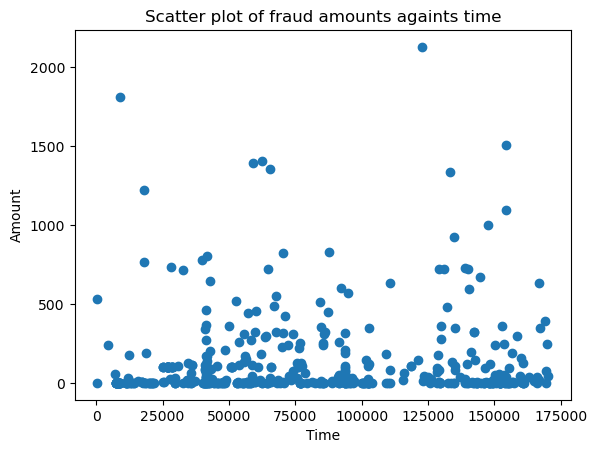

In [37]:
# Display fraud amounts according to time

plt.scatter(plot_fraud['Time'], plot_fraud['Amount'])

plt.title('Scatter plot of fraud amounts againts time')
plt.xlabel('Time')
plt.ylabel('Amount')


In [42]:
# Distribution of fraud and non fraud

n_fraud = len(data[data.Class == 1])
print('number of frauds = ' + str(n_fraud))

n_legit = len(data[data.Class == 0])
print('number of legitimate transactions = ' + str(n_legit))

number of frauds = 473
number of legitimate transactions = 283253
